# ImageStacking 📚

This notebook aims to explore the purpose of Image Stacking and observe how capturing multiple short exposures is advantegeous than one single exposure for Astrophotography. 

**Author:** [Timothy Do](https://timothydo.me)

## References
[1] PhotographingSpace.com. (2023, December 22). Homework: Download and Stack my Data! [Online]. Available: https://www.photographingspace.com/homework-download-stack-data/

## Dependencies

In [1]:
!pip install -r ../requirements.txt

In [2]:
# Dependencies
import os
import numpy as np
import rawpy
import cv2 as cv
import matplotlib.pyplot as plt 
from tqdm import tqdm

In [3]:
# Global Helper Functions
# Crudely Normalize an Image from 0-1
def normalize(img):
    return (img - img.min())/(img.max()-img.min())

# Contrast Stretches an Image
def contrast_strech(img,min=0,max=1):
    return normalize(img) * (max-min) + min

# Converts CR2 to Numpy Array
def cr2_to_numpy(cr2Path,uint=False):
    with rawpy.imread(cr2Path) as raw:
        if(uint):
            out = raw.postprocess() # uint8
        else:
            out = raw.postprocess(use_camera_wb=True,half_size=False,output_bps=32,no_auto_bright=False)
            out = out.astype(np.float32)/ 2**16
    return out

## Downloading the Data
For exploring the process of Image Stacking, we will be downloading a "Homework" example from Cory Schmitz's blog in the Photograph Space site! He takes a really nice shot of the milky way that we can work with. [1]

Here are some logisitcs of the stack, taken on a static tripod: 

- **Camera:** Canon 5D Mark III 
- **ISO:** 6400
- **Exposure Length:** 15 seconds
- **White Balance:** 4250K

In [4]:
# Creating Directory to Store the Data
dataDir = '../data/imagestacking'
os.makedirs(dataDir,exist_ok=True)

In [5]:
# Downloading the Single Raw Image & Full Stack
site = "https://www.photographingspace.com/downloads/"
singleRawFile = "CSM30803.CR2"
stackFile = "11x_ISO6400_f2.8_15s_5DMkIII_raw.zip"
for file in [singleRawFile,stackFile]: 
    filePath = f'{dataDir}/{file}'
    if(not(os.path.exists(filePath))):
        fileLink = f'{site}/{file}'
        os.system(f'curl {fileLink} -o {filePath}')
    if(file.endswith('.zip')):
        zipDir = filePath.split('.zip')[0]
        if(not(os.path.exists(zipDir))):
            os.system(f'unzip {filePath} -d {zipDir}')

## Visualizing the Data

Single Raw Numpy Shape: (3870, 5796, 3)
Single Raw Numpy Data Type: float32


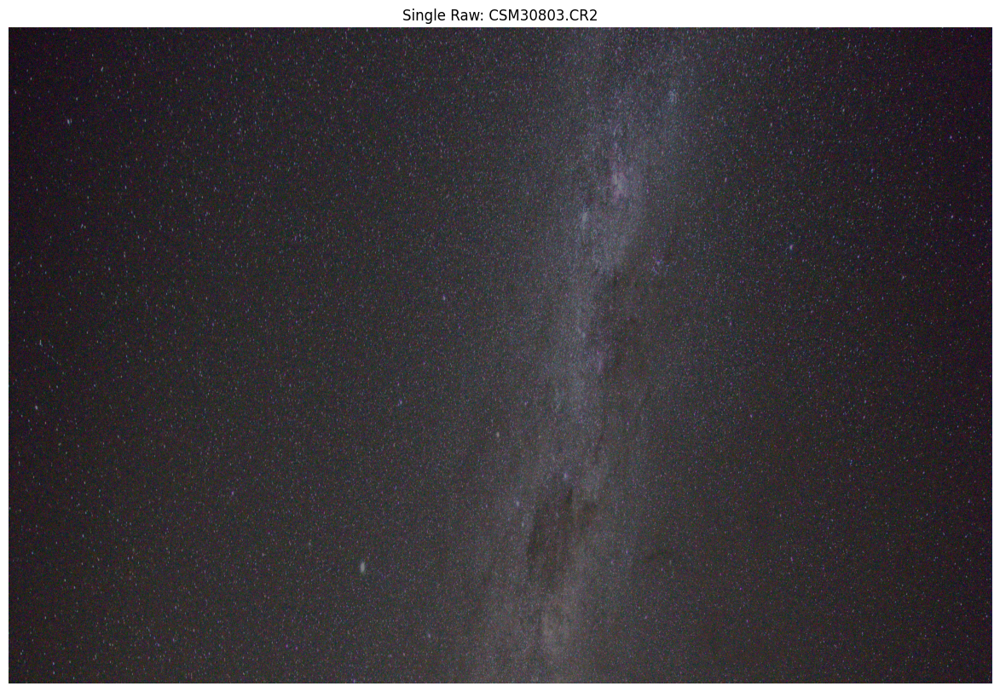

In [6]:
# Extracting Single Raw Image & Viewing
singleRawPath = f'{dataDir}/{singleRawFile}'
singleRaw = cr2_to_numpy(singleRawPath)
print(f'Single Raw Numpy Shape: {singleRaw.shape}')
print(f'Single Raw Numpy Data Type: {singleRaw.dtype}')

# Plotting
plt.figure(figsize=(15,10))
plt.title(f'Single Raw: {singleRawFile}')
plt.imshow(contrast_strech(singleRaw))
plt.axis('off')
plt.show()

In [7]:
# Read the Stacks into Memory
stackPath = f'{dataDir}/11x_ISO6400_f2.8_15s_5DMkIII_raw/raw'
stackFiles = sorted([file for file in os.listdir(stackPath) if file.endswith('.CR2')])
print(f'Stack Files: {stackFiles}')
print('Stacking Raw Images into a Tensor')
stackedNumpy = np.stack([cr2_to_numpy(f'{stackPath}/{stackFile}') for stackFile in tqdm(stackFiles)])
print(f'Stacked Numpy Shape: {stackedNumpy.shape}')
print(f'Stacked Numpy Data Type: {stackedNumpy.dtype}')

Stack Files: ['CSM30799.CR2', 'CSM30800.CR2', 'CSM30801.CR2', 'CSM30802.CR2', 'CSM30803.CR2', 'CSM30804.CR2', 'CSM30805.CR2', 'CSM30806.CR2', 'CSM30807.CR2', 'CSM30808.CR2', 'CSM30809.CR2']
Stacking Raw Images into a Tensor


100%|██████████| 11/11 [00:08<00:00,  1.33it/s]


Stacked Numpy Shape: (11, 3870, 5796, 3)
Stacked Numpy Data Type: float32


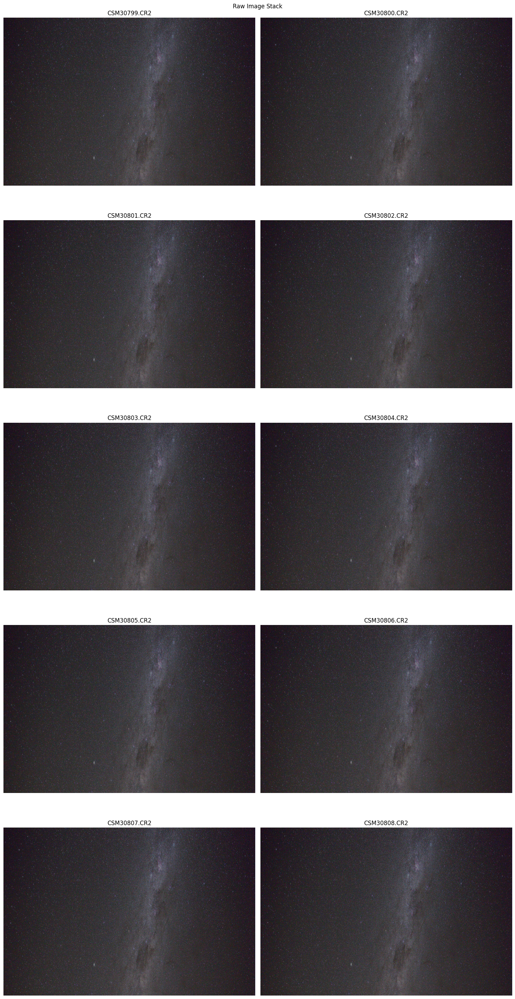

In [8]:
# Viewing the Stack
rows = 5
cols = 2
fig, ax = plt.subplots(nrows=rows,ncols=cols,figsize=(15,30))
plt.suptitle('Raw Image Stack')
for i in range(rows):
    for j in range(cols):
        ax[i][j].axis('off')
        ax[i][j].set_title(stackFiles[(i*cols)+j])
        ax[i][j].imshow(stackedNumpy[(i*cols)+j])
plt.tight_layout()
plt.show()

## Stacking Methods
 We will explore stacking methods in order to reduce noise and have the deep sky objects really pop out! We first start off with Naive methods, which work by avergaing the images to filter noise. The noise is coming from the shot, coming from readout, thermal, etc. They work in the ideal setting (i.e., when there is no parallax between scenes), but not in the real world because of star trails.
 
 Star trails are caused when the stars rotate with the Earth's rotation in perspective of the shot, so we need to perform image registartion before stacking the images!

### Simulation

We first provide an ideal scene, where a test scene is generated with a simulated deep sky object.

In [9]:
# Helper Functions to Simulate Noise
# Creating Test Scene 
def createTestScene(width=4000,height=3000,radius=100):
    # Image dimensions
    # Create an empty image (black background)
    image = np.zeros((height, width,3))

    # Define circle parameters
    center_x = width // 2
    center_y = height // 2

    # Create a meshgrid
    y, x = np.ogrid[-center_y:height-center_y, -center_x:width-center_x]

    # Calculate distance from center
    dist_from_center = np.sqrt(x**2 + y**2)

    # Set pixels within the circle to white
    image[dist_from_center <= radius] = 1
    return image

# Genereates Noise with Zero Mean and Unit Variance 
def createNoise(width=4000,height=3000,dist='uniform'):
    if(dist == 'uniform'):
        noise = np.random.rand(height,width,3)
    elif(dist == 'gauss'):
        noise = np.random.randn(height,width,3)
    return normalize(noise)

Test Scene Shape: (3000, 4000, 3)
Test Scene Data Type: float64


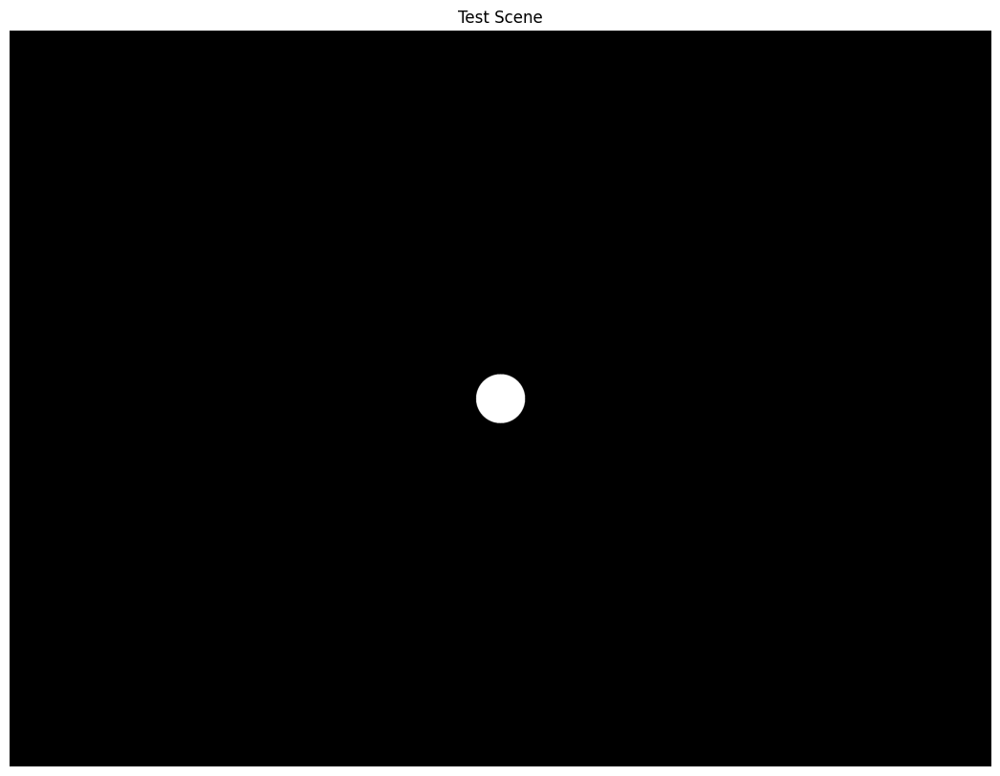

In [10]:
testScene = createTestScene()
print(f'Test Scene Shape: {testScene.shape}')
print(f'Test Scene Data Type: {testScene.dtype}')
plt.figure(figsize=(15,10))
plt.imshow(testScene)
plt.title('Test Scene')
plt.axis('off')
plt.show()

Test Noise Shape: (3000, 4000, 3)
Test Noise Data Type: float64
Test Noise Min: 0.0
Test Noise Max: 1.0


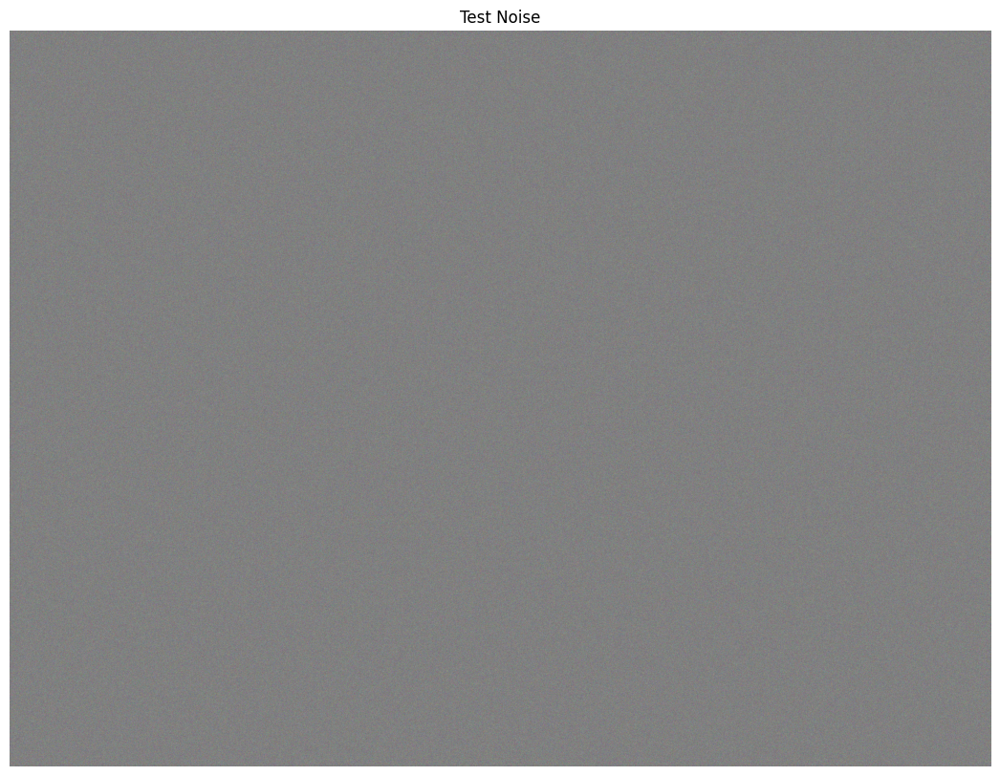

In [11]:
testNoise = createNoise(dist='gauss')
print(f'Test Noise Shape: {testNoise.shape}')
print(f'Test Noise Data Type: {testNoise.dtype}')
print(f'Test Noise Min: {testNoise.min()}')
print(f'Test Noise Max: {testNoise.max()}')
plt.figure(figsize=(15,10))
plt.imshow(testNoise)
plt.title('Test Noise')
plt.axis('off')
plt.show()

In [12]:
# Generate the Noisy Stack 
scale = 0.25
numStack = 25
print('Creating Test Stack...')
testStack = np.stack([testScene + scale*createNoise(dist='gauss') for _ in tqdm(range(numStack))])
print(f'Test Stack Shape: {testStack.shape}')

Creating Test Stack...


100%|██████████| 25/25 [00:12<00:00,  1.97it/s]


Test Stack Shape: (25, 3000, 4000, 3)


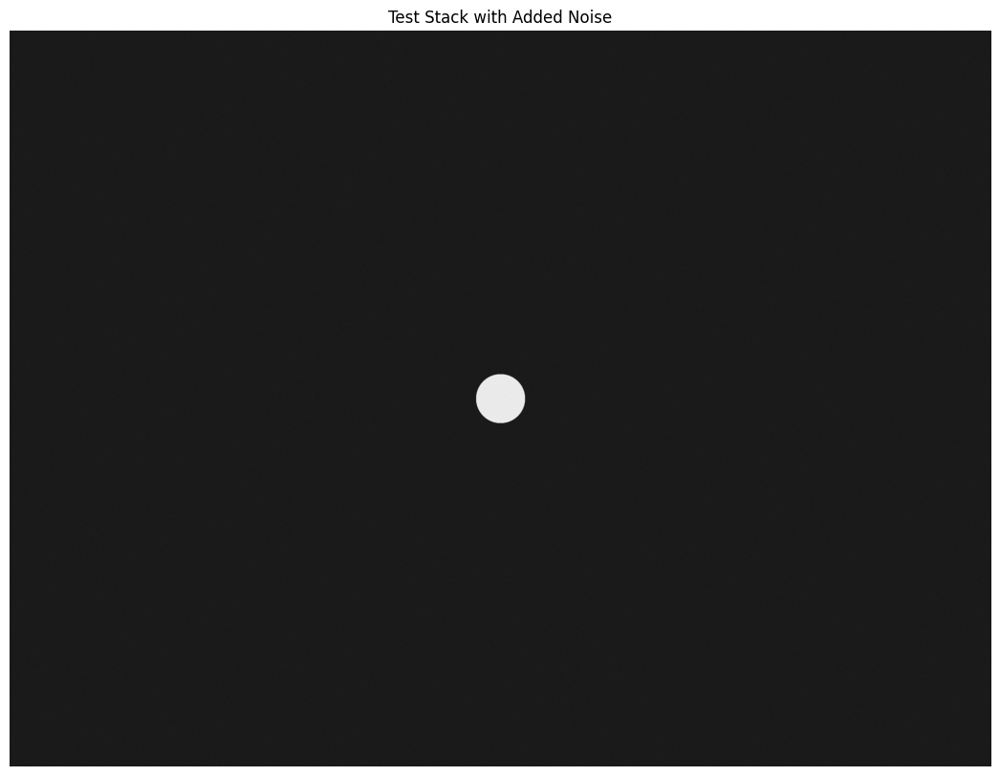

In [13]:
plt.figure(figsize=(15,10))
plt.title('Test Stack with Added Noise')
plt.axis('off')
plt.imshow(normalize(testStack[0]))
plt.show()

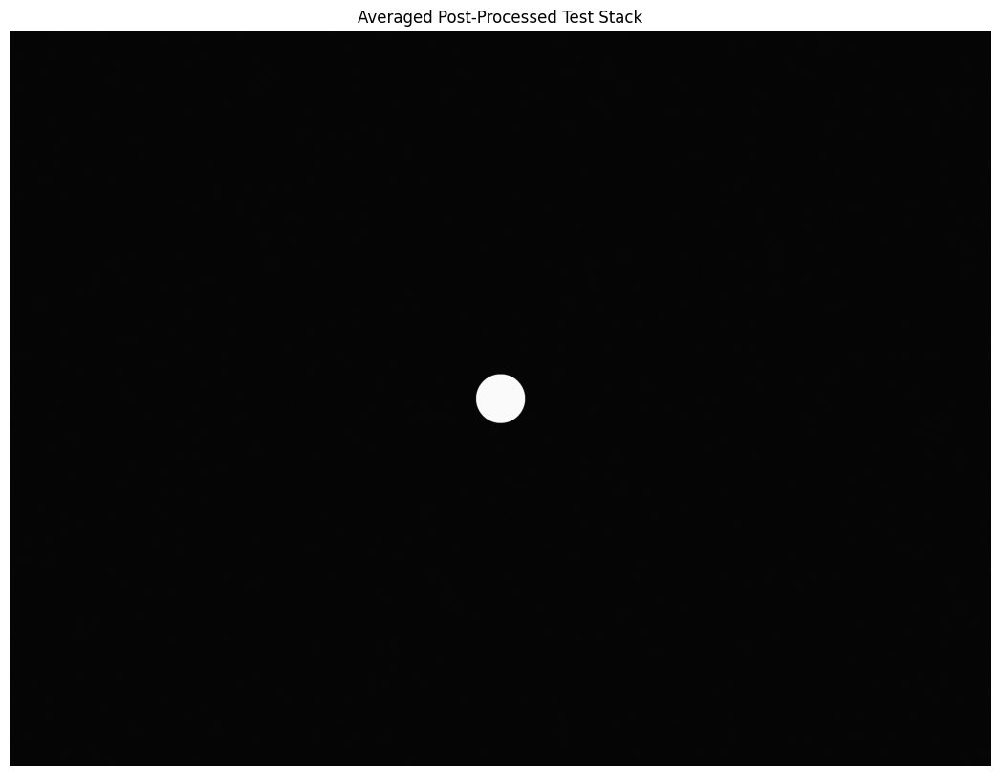

In [14]:
# Viewing the Average Raw Image (Naive Stacking)
testMean = np.mean(testStack,axis=0)
# Plotting the Average
plt.figure(figsize=(15,10))
plt.title(f'Averaged Post-Processed Test Stack')
plt.imshow(normalize(testMean))
plt.axis('off')
plt.show()

### Real Images

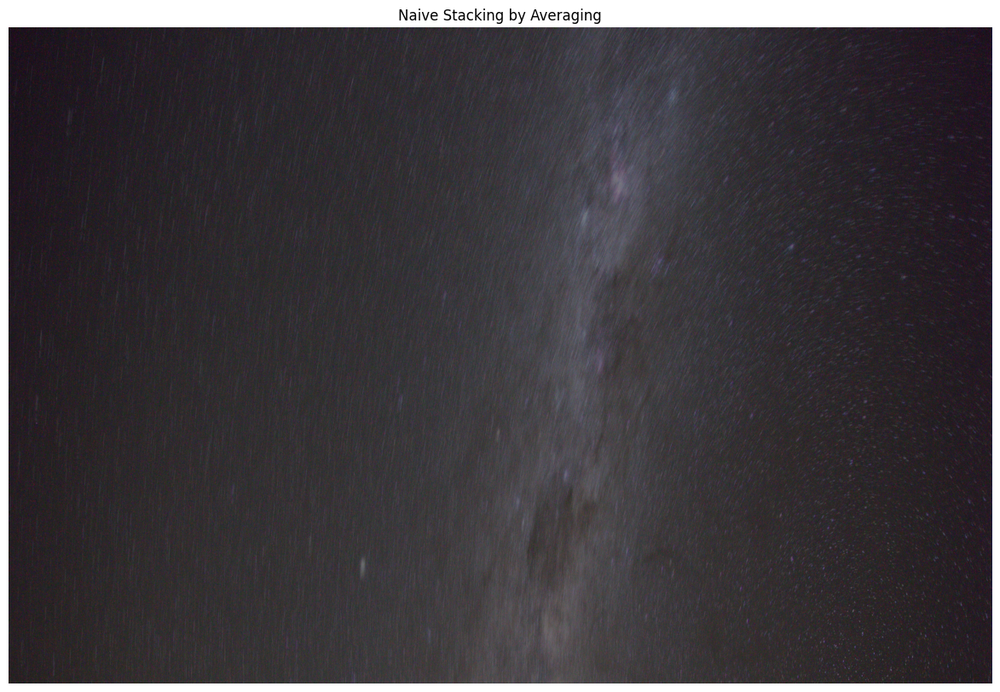

In [15]:
# Viewing the Average Raw Image (Naive Stacking)
stackedMean = np.mean(stackedNumpy,axis=0)
# Plotting the Average
plt.figure(figsize=(15,10))
plt.title(f'Naive Stacking by Averaging')
plt.imshow(stackedMean)
plt.axis('off')
plt.show()

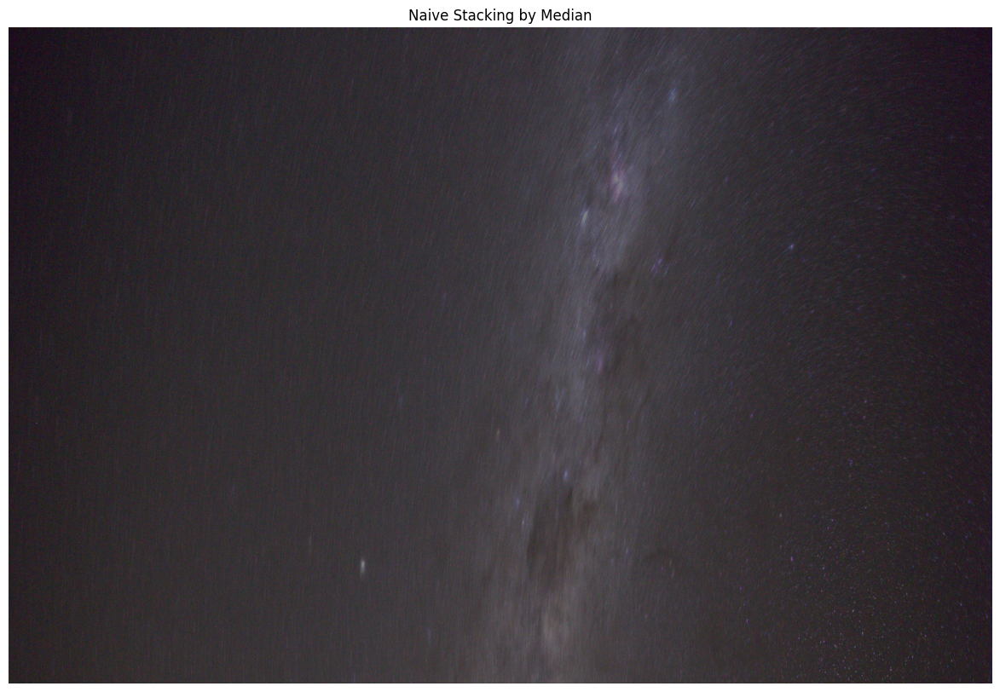

In [16]:
# Viewing the Median Raw Image (Naive Stacking)
stackedMedian = np.median(stackedNumpy,axis=0)
# Plotting the Median
plt.figure(figsize=(15,10))
plt.title(f'Naive Stacking by Median')
plt.imshow(stackedMedian)
plt.axis('off')
plt.show()